# Multi-Class Image Classification Model for 7000 Labeled Pokémon Using TensorFlow Take 4
### David Lowe
### February 4, 2022

Template Credit: Adapted from a template made available by Dr. Jason Brownlee of Machine Learning Mastery. [https://machinelearningmastery.com/]

SUMMARY: This project aims to construct a predictive model using a TensorFlow convolutional neural network (CNN) and document the end-to-end steps using a template. The 7000 Labeled Pokémon dataset is a multi-class classification situation where we attempt to predict one of several (more than two) possible outcomes.

INTRODUCTION: The dataset owner worked on a Pokémon classification project and made the dataset available on Kaggle. The dataset includes 150 Pokémon’s with 25 to 50 images for each Pokémon. Unfortunately, most images have low resolution, so we should be mindful of the results that we can obtain from this dataset.

ANALYSIS: The model's performance achieved an accuracy score of 59.79% after 50 epochs using a validation dataset with 15% of total images. After tuning the learning rate, we obtained a final accuracy rate to 60.73% using the same validation dataset.

CONCLUSION: In this iteration, the TensorFlow ResNet152V2 CNN model appeared to have limited effectiveness in modeling this dataset.

Dataset Used: 7000 Labeled Pokémon Dataset

Dataset ML Model: Multi-class image classification with numerical attributes

Dataset Reference: https://www.kaggle.com/lantian773030/pokemonclassification

One potential source of performance benchmarks: https://www.kaggle.com/lantian773030/pokemonclassification/code

# Task 1 - Prepare Environment

In [1]:
# # Install the packages to support accessing environment variable and SQL databases
# !pip install python-dotenv PyMySQL boto3

In [2]:
# Retrieve GPU configuration information
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
    print('Select the Runtime → "Change runtime type" menu to enable a GPU accelerator, ')
    print('and then re-execute this cell.')
else:
    print(gpu_info)

Fri Jan 28 17:15:21 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.91.03    Driver Version: 460.91.03    CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 5000     Off  | 00000000:00:05.0 Off |                  Off |
| 33%   27C    P8     8W / 230W |      0MiB / 16125MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
# Retrieve memory configuration information
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
    print('To enable a high-RAM runtime, select the Runtime → "Change runtime type"')
    print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
    print('re-execute this cell.')
else:
    print('You are using a high-RAM runtime!')

Your runtime has 31.6 gigabytes of available RAM

You are using a high-RAM runtime!


In [4]:
# Retrieve CPU information from the system
ncpu = !nproc
print("The number of available CPUs is:", ncpu[0])

The number of available CPUs is: 8


In [5]:
# # Mount Google Drive locally for loading the dotenv files
# from dotenv import load_dotenv
# from google.colab import drive
# drive.mount('/content/gdrive')
# gdrivePrefix = '/content/gdrive/My Drive/Colab_Downloads/'
# env_path = '/content/gdrive/My Drive/Colab Notebooks/'
# dotenv_path = env_path + "python_script.env"
# load_dotenv(dotenv_path=dotenv_path)

## 1.a) Load libraries and modules

In [6]:
# Set the random seed number for reproducible results
RNG_SEED = 88

In [7]:
import random
random.seed(RNG_SEED)
import numpy as np
np.random.seed(RNG_SEED)
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import sys
import math
# import boto3
import zipfile
from datetime import datetime
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

import tensorflow as tf
tf.random.set_seed(RNG_SEED)
from tensorflow import keras
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator

## 1.b) Set up the controlling parameters and functions

In [8]:
# Begin the timer for the script processing
START_TIME_SCRIPT = datetime.now()

In [9]:
# Set up the number of CPU cores available for multi-thread processing
N_JOBS = 1

# Set up the flag to stop sending progress emails (setting to True will send status emails!)
NOTIFY_STATUS = False

# Set the percentage sizes for splitting the dataset
TEST_SET_RATIO = 0.2
VAL_SET_RATIO = 0.15

# Set the number of folds for cross validation
N_FOLDS = 5
N_ITERATIONS = 1

# Set various default modeling parameters
DEFAULT_LOSS = 'categorical_crossentropy'
DEFAULT_METRICS = ['accuracy']
DEFAULT_OPTIMIZER = tf.keras.optimizers.Adam(learning_rate=0.0005)
CLASSIFIER_ACTIVATION = 'softmax'
MAX_EPOCHS = 50
BATCH_SIZE = 32
NUM_CLASSES = 150
# CLASS_LABELS = []
# CLASS_NAMES = []
# RAW_IMAGE_SIZE = (1280, 720)
TARGET_IMAGE_SIZE = (224, 224)
INPUT_IMAGE_SHAPE = (TARGET_IMAGE_SIZE[0], TARGET_IMAGE_SIZE[1], 3)

# Define the labels to use for graphing the data
TRAIN_METRIC = "accuracy"
VALIDATION_METRIC = "val_accuracy"
TRAIN_LOSS = "loss"
VALIDATION_LOSS = "val_loss"

# Define the directory locations and file names
STAGING_DIR = 'staging/'
TRAIN_DIR = 'staging/PokemonData/'
VALID_DIR = ''
TEST_DIR = ''
TRAIN_DATASET = 'PokemonData.zip'
# VALID_DATASET = ''
# TEST_DATASET = ''
# TRAIN_LABELS = ''
# VALID_LABELS = ''
# TEST_LABELS = ''
# OUTPUT_DIR = 'staging/'
# SAMPLE_SUBMISSION_CSV = 'sample_submission.csv'
# FINAL_SUBMISSION_CSV = 'submission.csv'

# Check the number of GPUs accessible through TensorFlow
print('Num GPUs Available:', len(tf.config.list_physical_devices('GPU')))

# Print out the TensorFlow version for confirmation
print('TensorFlow version:', tf.__version__)

Num GPUs Available: 1
TensorFlow version: 2.6.0


2022-01-28 17:15:26.958026: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-28 17:15:27.142490: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-28 17:15:27.143406: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


In [10]:
# Set up the email notification function
def status_notify(msg_text):
    access_key = os.environ.get('SNS_ACCESS_KEY')
    secret_key = os.environ.get('SNS_SECRET_KEY')
    aws_region = os.environ.get('SNS_AWS_REGION')
    topic_arn = os.environ.get('SNS_TOPIC_ARN')
    if (access_key is None) or (secret_key is None) or (aws_region is None):
        sys.exit("Incomplete notification setup info. Script Processing Aborted!!!")
    sns = boto3.client('sns', aws_access_key_id=access_key, aws_secret_access_key=secret_key, region_name=aws_region)
    response = sns.publish(TopicArn=topic_arn, Message=msg_text)
    if response['ResponseMetadata']['HTTPStatusCode'] != 200 :
        print('Status notification not OK with HTTP status code:', response['ResponseMetadata']['HTTPStatusCode'])

In [11]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 1 - Prepare Environment has begun on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

In [12]:
# Reset the random number generators
def reset_random(x=RNG_SEED):
    random.seed(x)
    np.random.seed(x)
    tf.random.set_seed(x)

In [13]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 1 - Prepare Environment completed on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

# Task 2 - Load and Prepare Images

In [14]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 2 - Load and Prepare Images has begun on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

In [15]:
# Clean up the old files and download directories before receiving new ones
!rm -rf staging/
# !rm PokemonData.zip
!mkdir staging/

In [16]:
if not os.path.exists(TRAIN_DATASET):
    !wget https://dainesanalytics.com/datasets/kaggle-7k-labeled-pokemon/PokemonData.zip

In [17]:
zip_ref = zipfile.ZipFile(TRAIN_DATASET, 'r')
zip_ref.extractall(STAGING_DIR)
zip_ref.close()

In [18]:
CLASS_LABELS = os.listdir(TRAIN_DIR)
print(CLASS_LABELS)

['Weezing', 'Magneton', 'Horsea', 'Rhydon', 'Meowth', 'Weedle', 'Machoke', 'Ivysaur', 'Vulpix', 'Snorlax', 'Persian', 'Rhyhorn', 'Cloyster', 'Mew', 'Poliwrath', 'Muk', 'Wartortle', 'Haunter', 'Koffing', 'Drowzee', 'Clefairy', 'Golem', 'Grimer', 'Venomoth', 'Venonat', 'Gastly', 'Gyarados', 'Omastar', 'Sandslash', 'Pidgey', 'Lickitung', 'Geodude', 'Raticate', 'Oddish', 'Dragonair', 'Hypno', 'Pidgeot', 'Charmeleon', 'Beedrill', 'Rapidash', 'Nidorina', 'Shellder', 'Jynx', 'Kingler', 'Poliwhirl', 'Arcanine', 'Diglett', 'Magikarp', 'Bellsprout', 'Eevee', 'Slowpoke', 'Caterpie', 'Golbat', 'Alolan Sandslash', 'Aerodactyl', 'Growlithe', 'Spearow', 'Venusaur', 'Psyduck', 'Gengar', 'Kadabra', 'Dragonite', 'Sandshrew', 'Farfetchd', 'Golduck', 'Metapod', 'Marowak', 'Kakuna', 'Arbok', 'Ditto', 'Gloom', 'Blastoise', 'Krabby', 'Jigglypuff', 'Machamp', 'Seadra', 'Hitmonchan', 'Porygon', 'Onix', 'Electrode', 'Pikachu', 'Alakazam', 'Vaporeon', 'Hitmonlee', 'Charizard', 'Mankey', 'Doduo', 'Fearow', 'Zubat

In [19]:
# Brief listing of training image files for each class
for c_label in CLASS_LABELS:
    training_class_dir = os.path.join(TRAIN_DIR, c_label)
    training_class_files = os.listdir(training_class_dir)
    print('Number of training images for', c_label, ':', len(os.listdir(training_class_dir)))
    print('Training samples for', c_label, ':', training_class_files[:5],'\n')

Number of training images for Weezing : 50
Training samples for Weezing : ['d7759ca041a54e40bcd0e5983593a398.jpg', '91e6d87ec73143f6870b49711c64916b.jpg', 'df575a5993254fbca9cdea90dd91588d.jpg', 'dbb9cf5baf0d4db7aa4106fe500713fc.jpg', '55da5238b2a04623b61594716a59bf6e.jpg'] 

Number of training images for Magneton : 41
Training samples for Magneton : ['74701c4706d24524b0e6824df017efb7.jpg', 'e91130d163b34d00861978d45b3fb469.jpg', '1d55877ba9b4494bb001171901671932.jpg', '7c768164302046448715448739d0212e.jpg', '60e1bc64ead04f18aba351a6e2db5f75.jpg'] 

Number of training images for Horsea : 54
Training samples for Horsea : ['bd17862b896a449da70d45c1b827da94.jpg', '131f3e3d7bb14e12bfedb59ed552f912.jpg', '766dbe0c94404183b230c0206157d08a.jpg', '2641402ac3804ff8812d1735b0a508ed.jpg', '49874a3c8de540d9abf96d312eb6eb07.jpg'] 

Number of training images for Rhydon : 50
Training samples for Rhydon : ['f3e42dbd8faf490294696b956c987f86.jpg', 'c579ed737b8c4f7f92bb6f7520d7ed2b.jpg', 'e0cc027ddbd448e

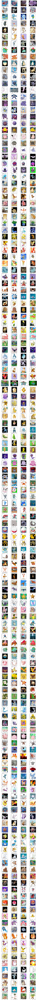

In [20]:
# Plot some training images from the dataset
nrows = len(CLASS_LABELS)
ncols = 4
training_examples = []
example_labels = []

fig = plt.gcf()
fig.set_size_inches(ncols * 4, nrows * 3)

for c_label in CLASS_LABELS:
    training_class_dir = os.path.join(TRAIN_DIR, c_label)
    training_class_files = os.listdir(training_class_dir)
    for j in range(ncols):
        training_examples.append(training_class_dir + '/' + training_class_files[j])
        example_labels.append(c_label)
    # print(training_examples)
    # print(example_labels)

for i, img_path in enumerate(training_examples):
    # Set up subplot; subplot indices start at 1
    sp = plt.subplot(nrows, ncols, i+1)
    sp.text(0, 0, example_labels[i])
    # sp.axis('Off')
    img = mpimg.imread(img_path)
    plt.imshow(img)
plt.show()

In [21]:
datagen_kwargs = dict(rescale=1./255, validation_split=VAL_SET_RATIO)
training_datagen = ImageDataGenerator(**datagen_kwargs)
validation_datagen = ImageDataGenerator(**datagen_kwargs)
dataflow_kwargs = dict(class_mode="categorical")

do_data_augmentation = True
if do_data_augmentation:
    training_datagen = ImageDataGenerator(rotation_range=45,
                                          horizontal_flip=True,
                                          vertical_flip=True,
                                          **datagen_kwargs)

print('Loading and pre-processing the training images...')
training_generator = training_datagen.flow_from_directory(directory=TRAIN_DIR,
                                                          target_size=TARGET_IMAGE_SIZE,
                                                          batch_size=BATCH_SIZE,
                                                          shuffle=True,
                                                          seed=RNG_SEED,
                                                          subset="training",
                                                          **dataflow_kwargs)
print('Number of training image batches per epoch of modeling:', len(training_generator))

print('Loading and pre-processing the validation images...')
validation_generator = validation_datagen.flow_from_directory(directory=TRAIN_DIR,
                                                              target_size=TARGET_IMAGE_SIZE,
                                                              batch_size=BATCH_SIZE,
                                                              shuffle=False,
                                                              subset="validation",
                                                              **dataflow_kwargs)
print('Number of validation image batches per epoch of modeling:', len(validation_generator))

Loading and pre-processing the training images...
Found 5866 images belonging to 150 classes.
Number of training image batches per epoch of modeling: 184
Loading and pre-processing the validation images...
Found 955 images belonging to 150 classes.
Number of validation image batches per epoch of modeling: 30


In [22]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 2 - Load and Prepare Images completed on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

# Task 3 - Define and Train Models

In [23]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 3 - Define and Train Models has begun on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

In [24]:
# Define the function for plotting training results for comparison
def plot_metrics(history):
    fig, axs = plt.subplots(1, 2, figsize=(24, 15))
    metrics =  [TRAIN_LOSS, TRAIN_METRIC]
    for n, metric in enumerate(metrics):
        name = metric.replace("_"," ").capitalize()
        plt.subplot(2,2,n+1)
        plt.plot(history.epoch, history.history[metric], color='blue', label='Train')
        plt.plot(history.epoch, history.history['val_'+metric], color='red', linestyle="--", label='Val')
        plt.xlabel('Epoch')
        plt.ylabel(name)
        if metric == TRAIN_LOSS:
            plt.ylim([0, plt.ylim()[1]])
        else:
            plt.ylim([0, 1])
        plt.legend()

In [25]:
# Define the baseline model for benchmarking
def create_nn_model(input_param=INPUT_IMAGE_SHAPE, output_param=NUM_CLASSES, dense_nodes=2048,
                    classifier_activation=CLASSIFIER_ACTIVATION, loss_param=DEFAULT_LOSS,
                    opt_param=DEFAULT_OPTIMIZER, metrics_param=DEFAULT_METRICS):
    base_model = keras.applications.resnet_v2.ResNet152V2(include_top=False, weights=None, input_shape=input_param)
    nn_model = keras.models.Sequential()
    nn_model.add(base_model)
    nn_model.add(keras.layers.Flatten())
    nn_model.add(keras.layers.Dense(dense_nodes, activation='relu')),
    nn_model.add(keras.layers.Dense(output_param, activation=classifier_activation))
    nn_model.compile(loss=loss_param, optimizer=opt_param, metrics=metrics_param)
    return nn_model

In [26]:
# Initialize the neural network model and get the training results for plotting graph
start_time_module = datetime.now()
tf.keras.backend.clear_session()
reset_random()
baseline_model = create_nn_model()
baseline_model_history = baseline_model.fit(training_generator,
                                            epochs=MAX_EPOCHS,
                                            validation_data=validation_generator,
                                            verbose=1)
print('Total time for model fitting:', (datetime.now() - start_time_module))

2022-01-28 17:17:50.483993: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-28 17:17:50.484994: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-28 17:17:50.485762: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-28 17:17:53.337510: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-01-28 17:17:53.338345: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read f

Epoch 1/50


2022-01-28 17:18:14.228868: I tensorflow/stream_executor/cuda/cuda_dnn.cc:381] Loaded cuDNN version 8204


184/184 [==============================] - 117s 505ms/step - loss: 8.6143 - accuracy: 0.0085 - val_loss: 5.0516 - val_accuracy: 0.0073
Epoch 2/50
184/184 [==============================] - 88s 474ms/step - loss: 4.7554 - accuracy: 0.0198 - val_loss: 4.9032 - val_accuracy: 0.0157
Epoch 3/50
184/184 [==============================] - 91s 495ms/step - loss: 4.3729 - accuracy: 0.0443 - val_loss: 4.3824 - val_accuracy: 0.0366
Epoch 4/50
184/184 [==============================] - 90s 486ms/step - loss: 3.8911 - accuracy: 0.0931 - val_loss: 3.9461 - val_accuracy: 0.0764
Epoch 5/50
184/184 [==============================] - 89s 481ms/step - loss: 3.4241 - accuracy: 0.1546 - val_loss: 3.6229 - val_accuracy: 0.1340
Epoch 6/50
184/184 [==============================] - 89s 481ms/step - loss: 3.1223 - accuracy: 0.2071 - val_loss: 3.5626 - val_accuracy: 0.1581
Epoch 7/50
184/184 [==============================] - 88s 476ms/step - loss: 2.8809 - accuracy: 0.2572 - val_loss: 5.3406 - val_accuracy: 0.

In [27]:
baseline_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet152v2 (Functional)     (None, 7, 7, 2048)        58331648  
_________________________________________________________________
flatten (Flatten)            (None, 100352)            0         
_________________________________________________________________
dense (Dense)                (None, 2048)              205522944 
_________________________________________________________________
dense_1 (Dense)              (None, 150)               307350    
Total params: 264,161,942
Trainable params: 264,018,198
Non-trainable params: 143,744
_________________________________________________________________


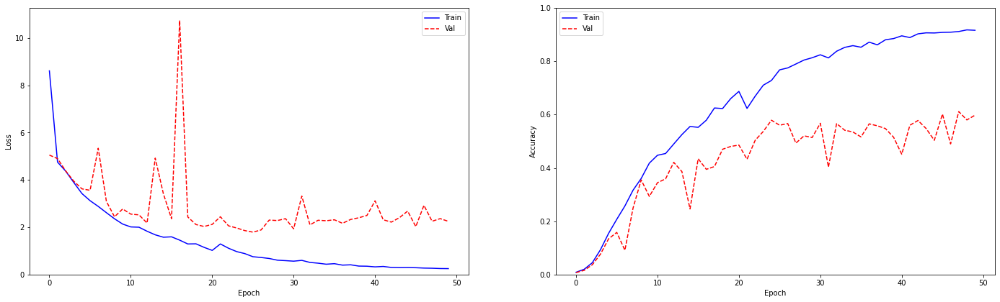

In [28]:
plot_metrics(baseline_model_history)

In [29]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 3 - Define and Train Models completed on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

# Task 4 - Tune and Optimize Models

In [30]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 4 - Tune and Optimize Models has begun on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

In [31]:
# Initialize the neural network model and get the training results for plotting graph
start_time_module = datetime.now()
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
TUNE_OPTIMIZER = tf.keras.optimizers.Adam(learning_rate=0.0001)
tf.keras.backend.clear_session()
reset_random()
tune_model = create_nn_model(opt_param=TUNE_OPTIMIZER)
tune_model_history = tune_model.fit(training_generator,
                                    epochs=MAX_EPOCHS,
                                    validation_data=validation_generator,
                                    callbacks=[learning_rate_reduction],
                                    verbose=1)
print('Total time for model fitting:', (datetime.now() - start_time_module))

Epoch 1/50
184/184 [==============================] - 101s 482ms/step - loss: 5.7966 - accuracy: 0.0092 - val_loss: 5.0163 - val_accuracy: 0.0073
Epoch 2/50
184/184 [==============================] - 87s 472ms/step - loss: 5.0109 - accuracy: 0.0061 - val_loss: 5.0102 - val_accuracy: 0.0063
Epoch 3/50
184/184 [==============================] - 87s 472ms/step - loss: 5.0015 - accuracy: 0.0113 - val_loss: 5.0099 - val_accuracy: 0.0084
Epoch 4/50
184/184 [==============================] - 87s 472ms/step - loss: 4.9930 - accuracy: 0.0121 - val_loss: 4.9947 - val_accuracy: 0.0136
Epoch 5/50
184/184 [==============================] - 87s 472ms/step - loss: 4.9895 - accuracy: 0.0128 - val_loss: 4.9827 - val_accuracy: 0.0126
Epoch 6/50
184/184 [==============================] - 87s 472ms/step - loss: 4.9769 - accuracy: 0.0113 - val_loss: 4.9775 - val_accuracy: 0.0157
Epoch 7/50
184/184 [==============================] - 87s 472ms/step - loss: 4.9645 - accuracy: 0.0140 - val_loss: 5.0734 - val_a

In [32]:
tune_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet152v2 (Functional)     (None, 7, 7, 2048)        58331648  
_________________________________________________________________
flatten (Flatten)            (None, 100352)            0         
_________________________________________________________________
dense (Dense)                (None, 2048)              205522944 
_________________________________________________________________
dense_1 (Dense)              (None, 150)               307350    
Total params: 264,161,942
Trainable params: 264,018,198
Non-trainable params: 143,744
_________________________________________________________________


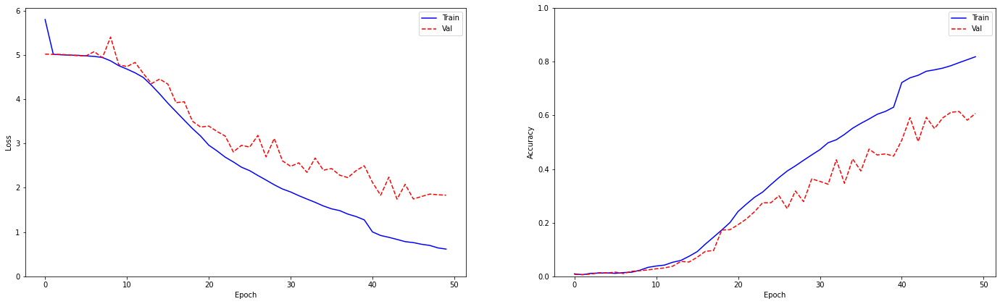

In [33]:
plot_metrics(tune_model_history)

In [34]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 4 - Tune and Optimize Models completed on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

# Task 5 - Finalize Model and Make Predictions

In [35]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 5 - Finalize Model and Make Predictions has begun on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

### 5.a) Train the Final Model

In [36]:
# Not applicable for this iteration of modeling

### 5.b) Load Test Dataset and Make Predictions

In [37]:
# Not applicable for this iteration of modeling

In [38]:
if NOTIFY_STATUS: status_notify('(TensorFlow Multi-Class) Task 5 - Finalize Model and Make Predictions completed on ' + datetime.now().strftime('%A %B %d, %Y %I:%M:%S %p'))

In [39]:
print ('Total time for the script:',(datetime.now() - START_TIME_SCRIPT))

Total time for the script: 2:48:02.016957
